# Computer Assignment 5

This is an all-in-one report to 6123 IVP, where the explanations, discussions and codes are included.

All experiments are run in Python code.

Import all libs we need

In [1]:
import numpy as np
import math
import matplotlib.pyplot as plt
import cv2
import time
import pywt

from numpy import linalg as LA

from matplotlib import rcParams
from matplotlib import rc
import scipy.stats as st
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from scipy.special import comb
rc('font', **{'family': 'serif', 'serif': ['Computer Modern']})
rc('text', usetex=True)
%matplotlib inline

In [2]:
print(__doc__)
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin
from sklearn.datasets import load_sample_image
from sklearn.utils import shuffle
from time import time

Automatically created module for IPython interactive environment


## 1. Image color quantization using K-means algorithm

Most of following code are cited and modified from http://sklearn.apachecn.org/cn/0.19.0/auto_examples/cluster/plot_color_quantization.html

### 1.1 Explore the influence of `k` selected

In [ ]:
def recreate_image(codebook, labels, w, h):
    """Recreate the (compressed) image from the code book & labels"""
    d = codebook.shape[1]
    image = np.zeros((w, h, d))
    label_idx = 0
    for i in range(w):
        for j in range(h):
            image[i][j] = codebook[labels[label_idx]]
            label_idx += 1
    return image

Fitting model on a small sub-sample of the data
done in 1.094s.
Predicting color indices on the full image (k-means)
done in 0.892s.
Predicting color indices on the full image (random)
done in 0.801s.


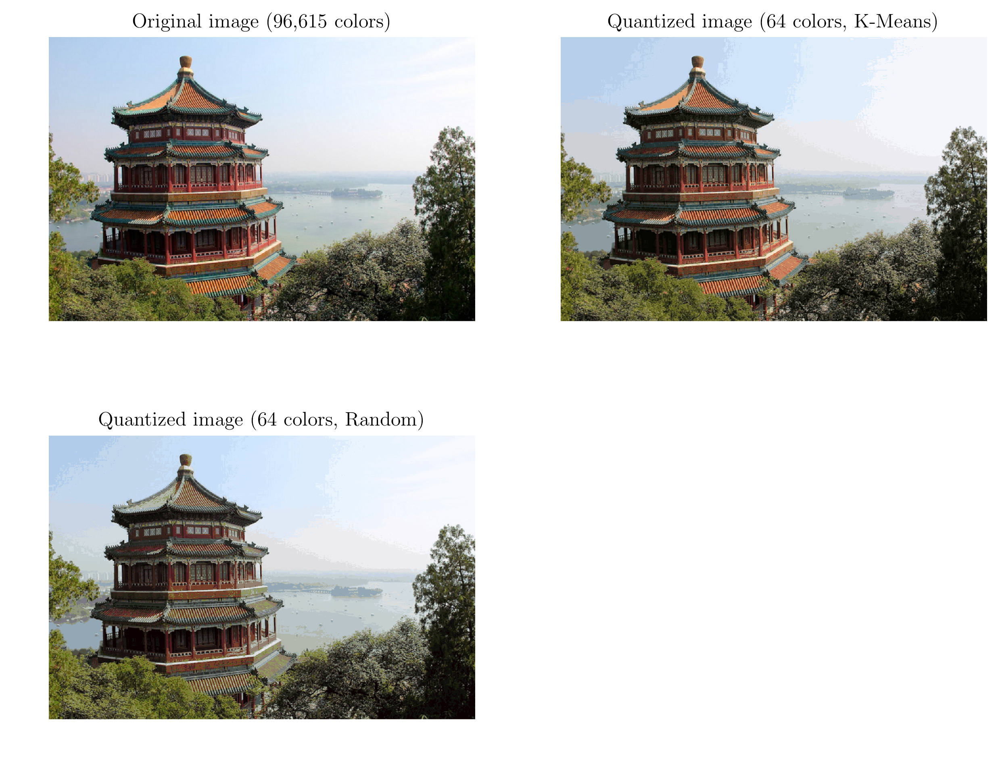

In [ ]:
n_colors = 64

# Load the Summer Palace photo
img_sp = cv2.imread('C:/Users/ZING/Desktop/6123/CA/Sol/CA5/sp.png')[:,:,[2,1,0]]

# Convert to floats instead of the default 8 bits integer coding. Dividing by
# 255 is important so that plt.imshow behaves works well on float data (need to
# be in the range [0-1])
img_sp = np.array(img_sp, dtype=np.float64) / 255

# Load Image and transform to a 2D numpy array.
w, h, d = original_shape = tuple(img_sp.shape)
assert d == 3
image_array = np.reshape(img_sp, (w * h, d))

print("Fitting model on a small sub-sample of the data")
t0 = time()
image_array_sample = shuffle(image_array, random_state=0)[:1000]
kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(image_array_sample)
print("done in %0.3fs." % (time() - t0))

# Get labels for all points
print("Predicting color indices on the full image (k-means)")
t0 = time()
labels = kmeans.predict(image_array)
print("done in %0.3fs." % (time() - t0))

codebook_random = shuffle(image_array, random_state=0)[:n_colors + 1]
print("Predicting color indices on the full image (random)")
t0 = time()
labels_random = pairwise_distances_argmin(codebook_random,
                                          image_array,
                                          axis=0)
print("done in %0.3fs." % (time() - t0))


# Display all results, alongside original image
plt.figure(dpi=300,figsize = [10,8])
plt.subplot(221)
plt.axis('off')
plt.title('Original image (96,615 colors)')
plt.imshow(img_sp)

plt.subplot(222)
plt.axis('off')
plt.title('Quantized image ('+str(n_colors)+' colors, K-Means)')
plt.imshow(recreate_image(kmeans.cluster_centers_, labels, w, h))

plt.subplot(223)
plt.axis('off')
plt.title('Quantized image ('+str(n_colors)+' colors, Random)')
plt.imshow(recreate_image(codebook_random, labels_random, w, h))
plt.show()

Fitting model on a small sub-sample of the data
done in 0.886s.
Predicting color indices on the full image (k-means)
done in 1.195s.
Predicting color indices on the full image (random)
done in 0.987s.


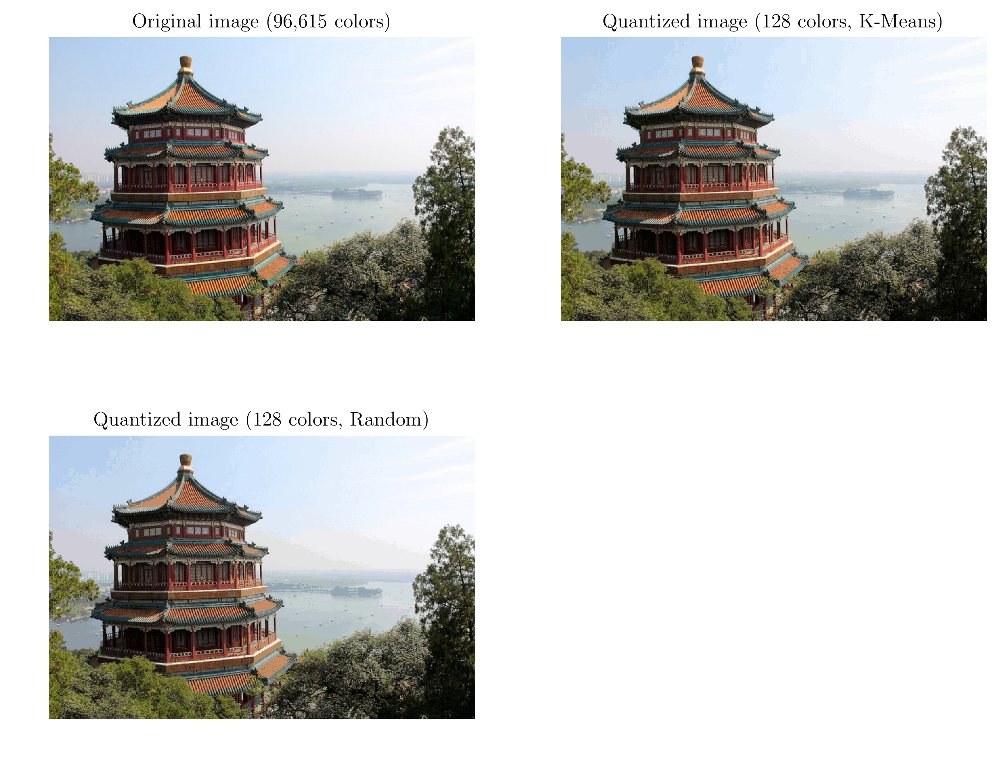

In [ ]:
n_colors = 128

# Load the Summer Palace photo
img_sp = cv2.imread('C:/Users/ZING/Desktop/6123/CA/Sol/CA5/sp.png')[:,:,[2,1,0]]

# Convert to floats instead of the default 8 bits integer coding. Dividing by
# 255 is important so that plt.imshow behaves works well on float data (need to
# be in the range [0-1])
img_sp = np.array(img_sp, dtype=np.float64) / 255

# Load Image and transform to a 2D numpy array.
w, h, d = original_shape = tuple(img_sp.shape)
assert d == 3
image_array = np.reshape(img_sp, (w * h, d))

print("Fitting model on a small sub-sample of the data")
t0 = time()
image_array_sample = shuffle(image_array, random_state=0)[:1000]
kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(image_array_sample)
print("done in %0.3fs." % (time() - t0))

# Get labels for all points
print("Predicting color indices on the full image (k-means)")
t0 = time()
labels = kmeans.predict(image_array)
print("done in %0.3fs." % (time() - t0))

codebook_random = shuffle(image_array, random_state=0)[:n_colors + 1]
print("Predicting color indices on the full image (random)")
t0 = time()
labels_random = pairwise_distances_argmin(codebook_random,
                                          image_array,
                                          axis=0)
print("done in %0.3fs." % (time() - t0))


# Display all results, alongside original image
plt.figure(dpi=300,figsize = [10,8])
plt.subplot(221)
plt.axis('off')
plt.title('Original image (96,615 colors)')
plt.imshow(img_sp)

plt.subplot(222)
plt.axis('off')
plt.title('Quantized image ('+str(n_colors)+' colors, K-Means)')
plt.imshow(recreate_image(kmeans.cluster_centers_, labels, w, h))

plt.subplot(223)
plt.axis('off')
plt.title('Quantized image ('+str(n_colors)+' colors, Random)')
plt.imshow(recreate_image(codebook_random, labels_random, w, h))
plt.show()

Fitting model on a small sub-sample of the data
done in 1.827s.
Predicting color indices on the full image (k-means)
done in 2.159s.
Predicting color indices on the full image (random)
done in 1.947s.


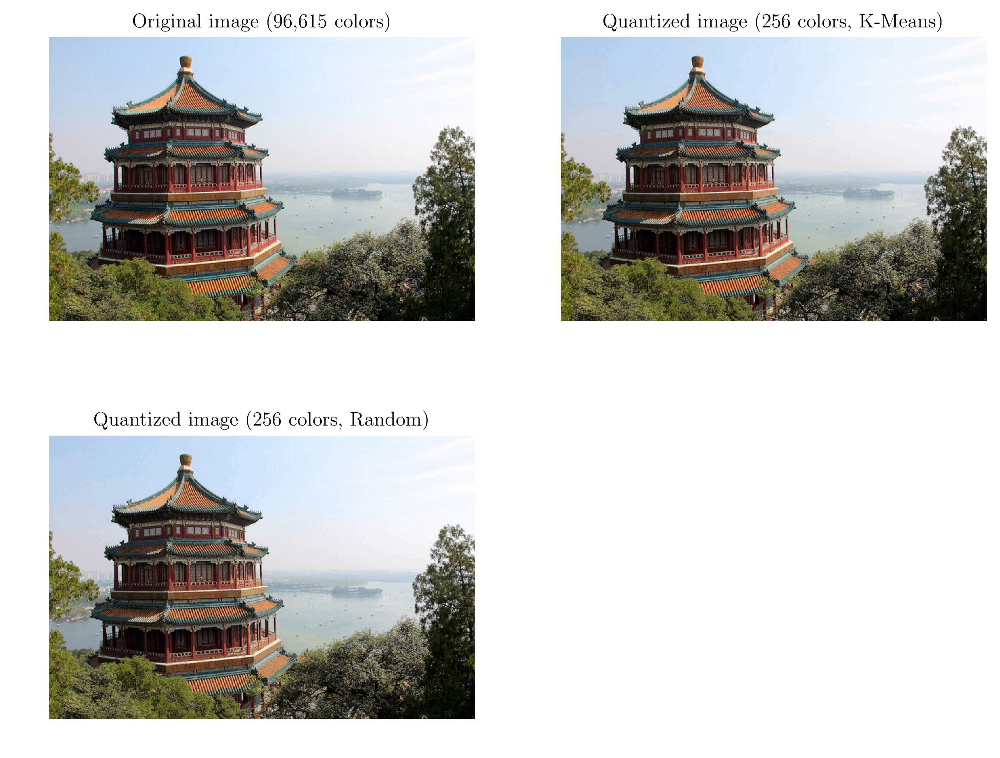

In [ ]:
n_colors = 256

# Load the Summer Palace photo
img_sp = cv2.imread('C:/Users/ZING/Desktop/6123/CA/Sol/CA5/sp.png')[:,:,[2,1,0]]

# Convert to floats instead of the default 8 bits integer coding. Dividing by
# 255 is important so that plt.imshow behaves works well on float data (need to
# be in the range [0-1])
img_sp = np.array(img_sp, dtype=np.float64) / 255

# Load Image and transform to a 2D numpy array.
w, h, d = original_shape = tuple(img_sp.shape)
assert d == 3
image_array = np.reshape(img_sp, (w * h, d))

print("Fitting model on a small sub-sample of the data")
t0 = time()
image_array_sample = shuffle(image_array, random_state=0)[:1000]
kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(image_array_sample)
print("done in %0.3fs." % (time() - t0))

# Get labels for all points
print("Predicting color indices on the full image (k-means)")
t0 = time()
labels = kmeans.predict(image_array)
print("done in %0.3fs." % (time() - t0))

codebook_random = shuffle(image_array, random_state=0)[:n_colors + 1]
print("Predicting color indices on the full image (random)")
t0 = time()
labels_random = pairwise_distances_argmin(codebook_random,
                                          image_array,
                                          axis=0)
print("done in %0.3fs." % (time() - t0))


# Display all results, alongside original image
plt.figure(dpi=300,figsize = [10,8])
plt.subplot(221)
plt.axis('off')
plt.title('Original image (96,615 colors)')
plt.imshow(img_sp)

plt.subplot(222)
plt.axis('off')
plt.title('Quantized image ('+str(n_colors)+' colors, K-Means)')
plt.imshow(recreate_image(kmeans.cluster_centers_, labels, w, h))

plt.subplot(223)
plt.axis('off')
plt.title('Quantized image ('+str(n_colors)+' colors, Random)')
plt.imshow(recreate_image(codebook_random, labels_random, w, h))
plt.show()

As `k` goes larger, the reconstructed image gets closer to the original image. In fact, when `k=w*h`, the reconstructed image will be just the original one.

Benchmark approach is generally not better than by K-means approach

### 1.2 Explore the influence of different initial method

Fitting model on a small sub-sample of the data with "k-means++"
done in 1.052s.
Fitting model on a small sub-sample of the data with "random"
done in 0.859s.


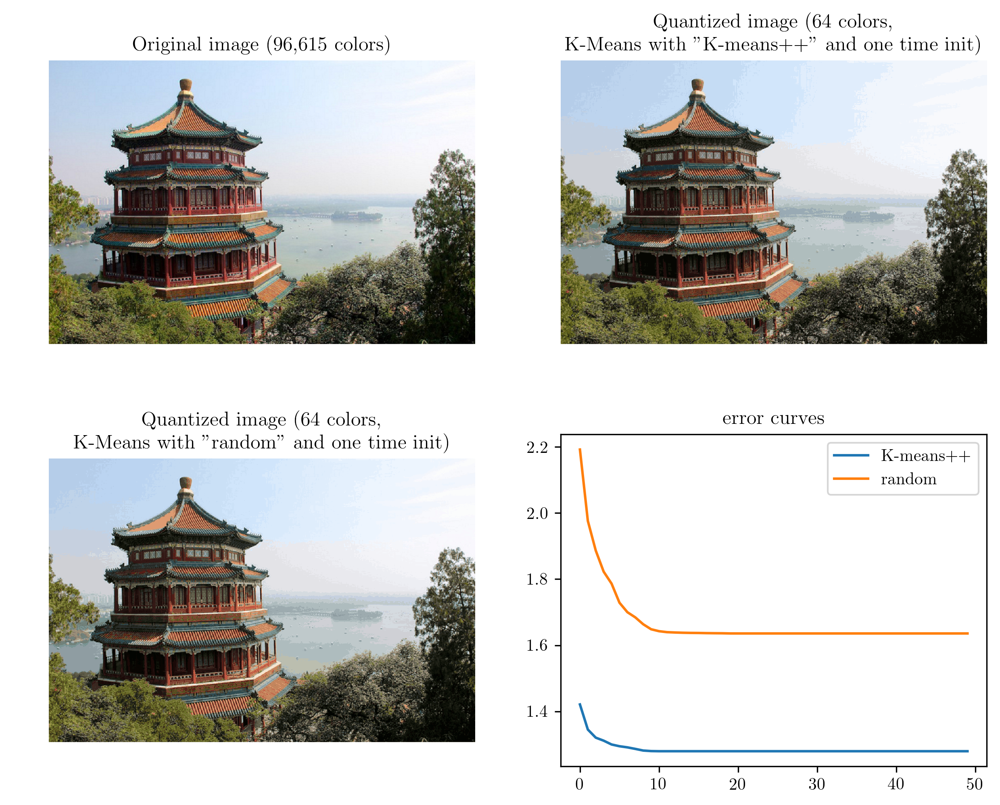

In [ ]:
n_colors = 64

# Load the Summer Palace photo
img_sp = cv2.imread('C:/Users/ZING/Desktop/6123/CA/Sol/CA5/sp.png')[:,:,[2,1,0]]

# Convert to floats instead of the default 8 bits integer coding. Dividing by
# 255 is important so that plt.imshow behaves works well on float data (need to
# be in the range [0-1])
img_sp = np.array(img_sp, dtype=np.float64) / 255

# Load Image and transform to a 2D numpy array.
w, h, d = original_shape = tuple(img_sp.shape)
assert d == 3
image_array = np.reshape(img_sp, (w * h, d))

inertias_k = []
inertias_r = []
print("Fitting model on a small sub-sample of the data with \"k-means++\"")
t0 = time()
image_array_sample = shuffle(image_array, random_state=0)[:1000]
kmeans = KMeans(n_clusters=n_colors, random_state=0, init='k-means++', n_init=1, max_iter=1)
kmeans.fit(image_array_sample)
cluster_centers = kmeans.cluster_centers_
inertia = kmeans.inertia_
inertias_k.append(inertia)
for _ in range(299):
    kmeans = KMeans(n_clusters=n_colors, random_state=0, init=cluster_centers, n_init=1, max_iter=1)
    kmeans.fit(image_array_sample)
    cluster_centers = kmeans.cluster_centers_
    inertia = kmeans.inertia_
    inertias_k.append(inertia)
print("done in %0.3fs." % (time() - t0))

print("Fitting model on a small sub-sample of the data with \"random\"")
t0 = time()
image_array_sample = shuffle(image_array, random_state=0)[:1000]
kmeans_r = KMeans(n_clusters=n_colors, random_state=0, init='random', n_init=1, max_iter=1)
kmeans_r.fit(image_array_sample)
cluster_centers = kmeans_r.cluster_centers_
inertia = kmeans_r.inertia_
inertias_r.append(inertia)
for _ in range(299):
    kmeans_r = KMeans(n_clusters=n_colors, random_state=0, init=cluster_centers, n_init=1, max_iter=1)
    kmeans_r.fit(image_array_sample)
    cluster_centers = kmeans_r.cluster_centers_
    inertia = kmeans_r.inertia_
    inertias_r.append(inertia)
print("done in %0.3fs." % (time() - t0))


# Get labels for all points
t0 = time()
labels = kmeans.predict(image_array)

labels_r = kmeans_r.predict(image_array)


# Display all results, alongside original image
plt.figure(dpi=300, figsize = [10,8])
plt.subplot(221)
plt.axis('off')
plt.title('Original image (96,615 colors)')
plt.imshow(img_sp)

plt.subplot(222)
plt.axis('off')
plt.title('Quantized image ('+str(n_colors)+' colors, \nK-Means with \"K-means++\" and one time init)')
plt.imshow(recreate_image(kmeans.cluster_centers_, labels, w, h))

plt.subplot(223)
plt.axis('off')
plt.title('Quantized image ('+str(n_colors)+' colors, \nK-Means with \"random\" and one time init)')
plt.imshow(recreate_image(kmeans_r.cluster_centers_, labels_r, w, h))

plt.subplot(224)
plt.plot(range(len(inertias_k))[0:50], inertias_k[0:50], label='K-means++')
plt.plot(range(len(inertias_r))[0:50], inertias_r[0:50], label='random')
plt.title('error curves')
plt.legend()

### 1.3 Explore the influence of different random seeds

Fitting model on a small sub-sample of the data with "k-means++"
done in 0.406s.
Fitting model on a small sub-sample of the data with "k-means++"
done in 0.556s.
Fitting model on a small sub-sample of the data with "k-means++"
done in 0.494s.
Fitting model on a small sub-sample of the data with "k-means++"
done in 0.608s.
Fitting model on a small sub-sample of the data with "k-means++"
done in 0.387s.


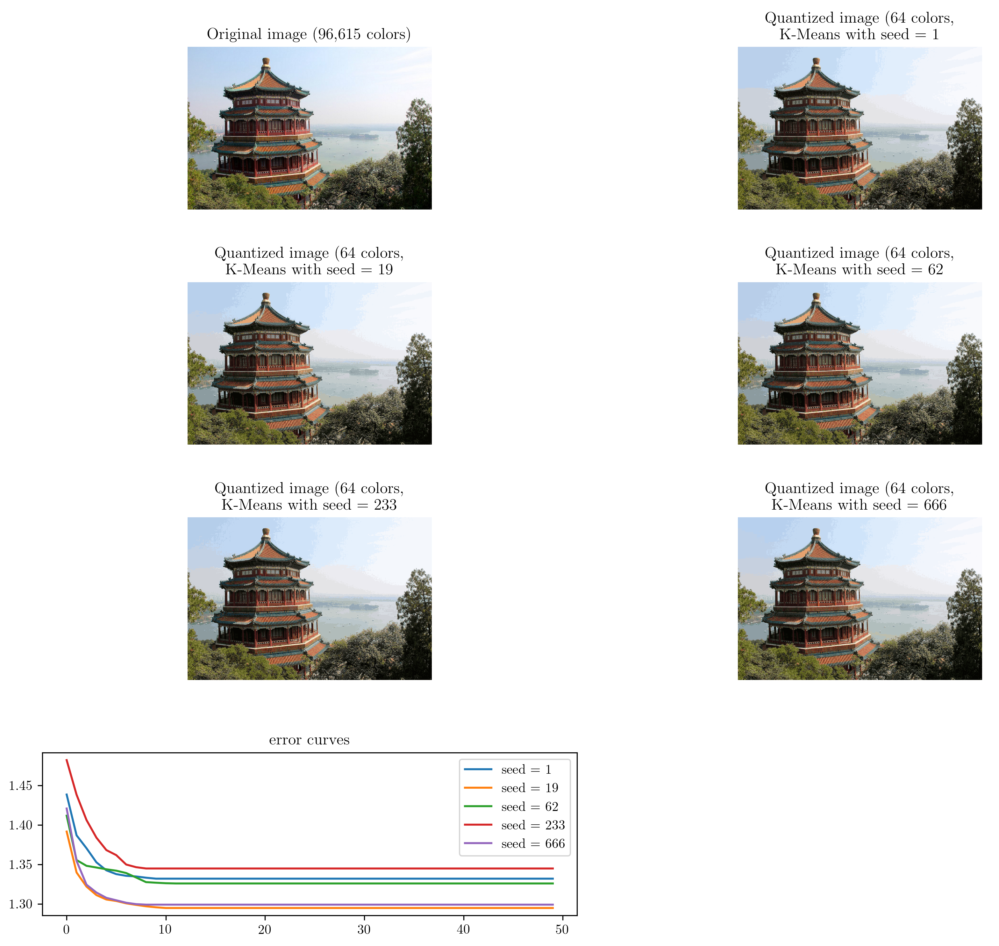

In [ ]:
n_colors = 64

# Load the Summer Palace photo
img_sp = cv2.imread('C:/Users/ZING/Desktop/6123/CA/Sol/CA5/sp.png')[:,:,[2,1,0]]

# Convert to floats instead of the default 8 bits integer coding. Dividing by
# 255 is important so that plt.imshow behaves works well on float data (need to
# be in the range [0-1])
img_sp = np.array(img_sp, dtype=np.float64) / 255

# Load Image and transform to a 2D numpy array.
w, h, d = original_shape = tuple(img_sp.shape)
assert d == 3
image_array = np.reshape(img_sp, (w * h, d))

random_state = [1,19,62,233,666]
inertias_hist = []
centers = []
labels = []
for i in range(5):
    inertias_hist.append([])
    print("Fitting model on a small sub-sample of the data with \"k-means++\"")
    t0 = time()
    image_array_sample = shuffle(image_array, random_state=0)[:1000]
    kmeans = KMeans(n_clusters=n_colors, random_state=random_state[i], init='k-means++', n_init=1, max_iter=1)
    kmeans.fit(image_array_sample)
    cluster_centers = kmeans.cluster_centers_
    inertia = kmeans.inertia_
    inertias_hist[i].append(inertia)
    for _ in range(99):
        kmeans = KMeans(n_clusters=n_colors, random_state=random_state[i], init=cluster_centers, n_init=1, max_iter=1)
        kmeans.fit(image_array_sample)
        cluster_centers = kmeans.cluster_centers_
        inertia = kmeans.inertia_
        inertias_hist[i].append(inertia)
    print("done in %0.3fs." % (time() - t0))
    centers.append(kmeans.cluster_centers_)
    labels.append(kmeans.predict(image_array))


# Display all results, alongside original image
plt.figure(dpi=300, figsize = [12,10])
plt.subplot(421)
plt.axis('off')
plt.title('Original image (96,615 colors)')
plt.imshow(img_sp)

for i in range(5):
    plt.subplot(422+i)
    plt.axis('off')
    plt.title('Quantized image ('+str(n_colors)+' colors, \nK-Means with seed = '+str(random_state[i]))
    plt.imshow(recreate_image(centers[i], labels[i], w, h))

plt.subplot(427)
for i in range(5):
    plt.plot(range(len(inertias_hist[i]))[0:50], inertias_hist[i][0:50], label='seed = '+str(random_state[i]))
plt.title('error curves')
plt.legend()

plt.tight_layout()

## 2. Image segmentation considering both color homogeneity and region connectivity

Fitting model on a small sub-sample of the data
done in 0.763s.
Fitting model on a small sub-sample of the data
done in 0.888s.
Fitting model on a small sub-sample of the data
done in 0.626s.


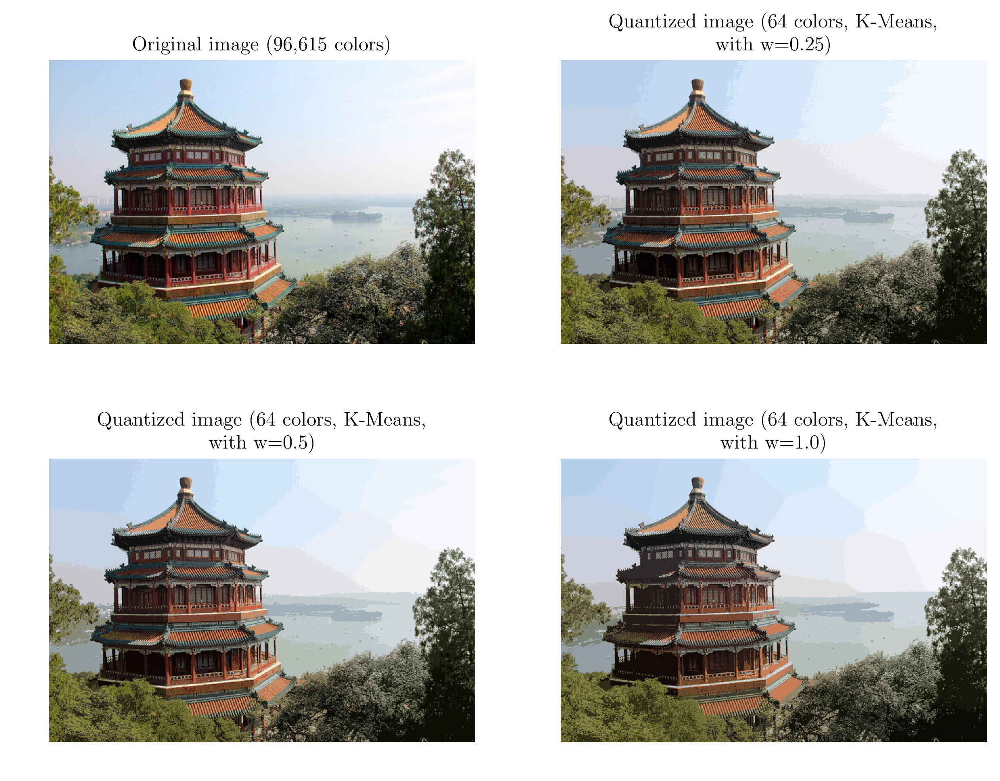

In [ ]:
n_colors = 64

# Load the Summer Palace photo
img_sp = cv2.imread('C:/Users/ZING/Desktop/6123/CA/Sol/CA5/sp.png')[:,:,[2,1,0]]

# Convert to floats instead of the default 8 bits integer coding. Dividing by
# 255 is important so that plt.imshow behaves works well on float data (need to
# be in the range [0-1])
img_sp = np.array(img_sp, dtype=np.float64) / 255

# Load Image and transform to a 2D numpy array.
w, h, d = original_shape = tuple(img_sp.shape)
assert d == 3
image_array = np.reshape(img_sp, (w * h, d))

w_s = [0.25, 0.5, 1.0]
cors = []
for wi in w_s:
    cor = np.array([np.linspace(1,w,w)[:,None] / (w * 1.0) * 1 * wi * np.ones([h])[None, :], 
                    np.ones([w])[:,None] * np.linspace(1,h,h)[None,:] / (h * 1.0) * 1.0 * wi])
    cor = np.moveaxis(np.array(cor), 0, -1)
    cor = np.reshape(cor, (w * h, 2))
    cors.append(cor)

centers = []
labels = []
for i in range(3):
    print("Fitting model on a small sub-sample of the data")
    t0 = time()
    train_data = np.hstack([image_array, cors[i]])
    #train_data = np.reshape(train_data, (w * h, d + 2))
    image_array_sample = shuffle(train_data, random_state=0)[:1500]
    kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(image_array_sample)
    print("done in %0.3fs." % (time() - t0))
    labels.append(kmeans.predict(train_data))
    centers.append(kmeans.cluster_centers_)


# Display all results, alongside original image
plt.figure(dpi=300,figsize = [10,8])
plt.subplot(221)
plt.axis('off')
plt.title('Original image (96,615 colors)')
plt.imshow(img_sp)

for i, wi in enumerate(w_s):
    plt.subplot(222+i)
    plt.axis('off')
    plt.title('Quantized image ('+str(n_colors)+' colors, K-Means, \n with w='+str(wi)+')')
    plt.imshow(recreate_image(centers[i][:,0:3], labels[i], w, h))
